
connect with drive
---



In [14]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


this code for unzip the folders

> Indented block


2.   List item



In [16]:
"""import os
from zipfile import ZipFile

# Define the path to your zip files
zip_files_path = '/content/drive/MyDrive/DalensAI_Image_dataset'

# Define the path for the new 'animals' folder
animals_folder_path = '/content/drive/MyDrive/DalensAI_Image_dataset/animals'

# Create the 'animals' folder if it doesn't exist
if not os.path.exists(animals_folder_path):
    os.makedirs(animals_folder_path)

# Iterate over each zip file in the specified directory
for zip_file_name in os.listdir(zip_files_path):
    if zip_file_name.endswith('.zip'):
        # Full path to the zip file
        zip_file_path = os.path.join(zip_files_path, zip_file_name)

        # Full path to the destination folder (inside the 'animals' folder)
        destination_folder = os.path.join(animals_folder_path, os.path.splitext(zip_file_name)[0])

        # Create the destination folder if it doesn't exist
        if not os.path.exists(destination_folder):
            os.makedirs(destination_folder)

        # Unzip the contents of the zip file into the destination folder
        with ZipFile(zip_file_path, 'r') as zip_ref:
            zip_ref.extractall(destination_folder)

print("Unzipping completed.")
"""

'import os\nfrom zipfile import ZipFile\n\n# Define the path to your zip files\nzip_files_path = \'/content/drive/MyDrive/DalensAI_Image_dataset\'\n\n# Define the path for the new \'animals\' folder\nanimals_folder_path = \'/content/drive/MyDrive/DalensAI_Image_dataset/animals\'\n\n# Create the \'animals\' folder if it doesn\'t exist\nif not os.path.exists(animals_folder_path):\n    os.makedirs(animals_folder_path)\n\n# Iterate over each zip file in the specified directory\nfor zip_file_name in os.listdir(zip_files_path):\n    if zip_file_name.endswith(\'.zip\'):\n        # Full path to the zip file\n        zip_file_path = os.path.join(zip_files_path, zip_file_name)\n\n        # Full path to the destination folder (inside the \'animals\' folder)\n        destination_folder = os.path.join(animals_folder_path, os.path.splitext(zip_file_name)[0])\n\n        # Create the destination folder if it doesn\'t exist\n        if not os.path.exists(destination_folder):\n            os.makedirs(de

In [17]:
"""import os
import shutil

# Define the path to the symbolic link
symbolic_link_path = '/content/drive/MyDrive/DalensAI_Image_dataset'

# Check if the symbolic link exists before attempting to delete
if os.path.islink(symbolic_link_path):
    # Remove the symbolic link
    os.unlink(symbolic_link_path)
    print(f"The symbolic link {symbolic_link_path} has been removed.")

# Check if the folder exists before attempting to delete
if os.path.exists(symbolic_link_path):
    # Use shutil.rmtree to delete the folder and its contents
    shutil.rmtree(symbolic_link_path)
    print(f"The folder {symbolic_link_path} has been deleted.")
else:
    print(f"The folder {symbolic_link_path} does not exist.")
"""

'import os\nimport shutil\n\n# Define the path to the symbolic link\nsymbolic_link_path = \'/content/drive/MyDrive/DalensAI_Image_dataset\'\n\n# Check if the symbolic link exists before attempting to delete\nif os.path.islink(symbolic_link_path):\n    # Remove the symbolic link\n    os.unlink(symbolic_link_path)\n    print(f"The symbolic link {symbolic_link_path} has been removed.")\n\n# Check if the folder exists before attempting to delete\nif os.path.exists(symbolic_link_path):\n    # Use shutil.rmtree to delete the folder and its contents\n    shutil.rmtree(symbolic_link_path)\n    print(f"The folder {symbolic_link_path} has been deleted.")\nelse:\n    print(f"The folder {symbolic_link_path} does not exist.")\n'

#Display the data./images

In [18]:
import os
import random
import matplotlib.image as mpimg

def display_random_images(folder_path, num_images=5):
    for animal_folder in os.listdir(folder_path):
        animal_folder_path = os.path.join(folder_path, animal_folder)

        if os.path.isdir(animal_folder_path):
            image_files = [f for f in os.listdir(animal_folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

            if len(image_files) >= num_images:
                random_images = random.sample(image_files, num_images)

                print(f"Random images from {animal_folder}:")
                for image in random_images:
                    image_path = os.path.join(animal_folder_path, image)
                    img = mpimg.imread(image_path)
                    plt.imshow(img)
                    plt.axis('off')
                    plt.show()

# Set the path to the main animals folder
animals_folder_path = "/content/drive/MyDrive/animals dataset"

# Display 5 random images from each subfolder
display_random_images(os.path.join(animals_folder_path, "healthy_animal"))
display_random_images(os.path.join(animals_folder_path, "unhealthy_animal"))


#print the number of classes and counts

In [19]:

def count_images_per_class(folder_path):
    class_count = 0
    total_count = 0

    for animal_folder in os.listdir(folder_path):
        animal_folder_path = os.path.join(folder_path, animal_folder)

        if os.path.isdir(animal_folder_path):
            image_files = [f for f in os.listdir(animal_folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
            num_images = len(image_files)

            if num_images > 0:
                print(f"{animal_folder}: {num_images} images")
                class_count += 1
                total_count += num_images

    print("\nTotal number of classes:", class_count)
    print("Total number of images:", total_count)

# Set the path to the main animals folder
animals_folder_path = "/content/drive/MyDrive/animals dataset"

# Count the number of classes and images per class
count_images_per_class(os.path.join(animals_folder_path, "healthy_animal"))
count_images_per_class(os.path.join(animals_folder_path, "unhealthy_animal"))



Total number of classes: 0
Total number of images: 0

Total number of classes: 0
Total number of images: 0


#split the data into train test and validation

In [20]:
"""import shutil
from sklearn.model_selection import train_test_split

# Set the path to your dataset
dataset_path = "/content/drive/MyDrive/animals dataset"

# Define the ratio for train, test, and validation sets
train_ratio = 0.7
test_ratio = 0.15
validation_ratio = 0.15

# Function to split data into train, test, and validation sets
def split_data(category_path):
    files = os.listdir(category_path)
    train, test = train_test_split(files, test_size=test_ratio + validation_ratio, random_state=42)
    test, validation = train_test_split(test, test_size=validation_ratio/(test_ratio + validation_ratio), random_state=42)

    return train, test, validation

# Iterate through healthy and unhealthy categories
categories = ["healthy_animal", "unhealthy_animal"]

for category in categories:
    category_path = os.path.join(dataset_path, category)

    # Iterate through specific animal types
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)

        # Create train, test, and validation directories for each animal type
        train_path = os.path.join(dataset_path, 'train', category, animal_type)
        test_path = os.path.join(dataset_path, 'test', category, animal_type)
        validation_path = os.path.join(dataset_path, 'validation', category, animal_type)

        os.makedirs(train_path, exist_ok=True)
        os.makedirs(test_path, exist_ok=True)
        os.makedirs(validation_path, exist_ok=True)

        # Split data for the current animal type
        train_data, test_data, validation_data = split_data(animal_type_path)

        # Move files to their respective directories
        for file in train_data:
            shutil.move(os.path.join(animal_type_path, file), os.path.join(train_path, file))

        for file in test_data:
            shutil.move(os.path.join(animal_type_path, file), os.path.join(test_path, file))

        for file in validation_data:
            shutil.move(os.path.join(animal_type_path, file), os.path.join(validation_path, file))
"""

'import shutil\nfrom sklearn.model_selection import train_test_split\n\n# Set the path to your dataset\ndataset_path = "/content/drive/MyDrive/animals dataset"\n\n# Define the ratio for train, test, and validation sets\ntrain_ratio = 0.7\ntest_ratio = 0.15\nvalidation_ratio = 0.15\n\n# Function to split data into train, test, and validation sets\ndef split_data(category_path):\n    files = os.listdir(category_path)\n    train, test = train_test_split(files, test_size=test_ratio + validation_ratio, random_state=42)\n    test, validation = train_test_split(test, test_size=validation_ratio/(test_ratio + validation_ratio), random_state=42)\n\n    return train, test, validation\n\n# Iterate through healthy and unhealthy categories\ncategories = ["healthy_animal", "unhealthy_animal"]\n\nfor category in categories:\n    category_path = os.path.join(dataset_path, category)\n\n    # Iterate through specific animal types\n    animal_types = os.listdir(category_path)\n\n    for animal_type in ani

#displaying the train test and validationn images for confermation of spliting

In [21]:
"""
import matplotlib.image as mpimg

# Set the path to your dataset
dataset_path = "/content/drive/MyDrive/animals dataset"

# Function to display random images from a directory with set information
def display_random_images_with_info(directory, set_info, category, animal_type, num_images=5):
    image_files = random.sample(os.listdir(directory), num_images)

    for image_file in image_files:
        image_path = os.path.join(directory, image_file)
        img = mpimg.imread(image_path)

        # Display image with set information, folder, and class name
        plt.imshow(img)
        plt.title(f"Set: {set_info}, Folder: {category}, Class: {animal_type}")
        plt.axis('off')
        plt.show()

# Display random images from the train set
train_path = os.path.join(dataset_path, 'train')
categories = os.listdir(train_path)

for category in categories:
    category_path = os.path.join(train_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Train", category, animal_type)

# Display random images from the test set
test_path = os.path.join(dataset_path, 'test')

for category in categories:
    category_path = os.path.join(test_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Test", category, animal_type)

# Display random images from the validation set
validation_path = os.path.join(dataset_path, 'validation')

for category in categories:
    category_path = os.path.join(validation_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Validation", category, animal_type)
"""

'\nimport matplotlib.image as mpimg\n\n# Set the path to your dataset\ndataset_path = "/content/drive/MyDrive/animals dataset"\n\n# Function to display random images from a directory with set information\ndef display_random_images_with_info(directory, set_info, category, animal_type, num_images=5):\n    image_files = random.sample(os.listdir(directory), num_images)\n\n    for image_file in image_files:\n        image_path = os.path.join(directory, image_file)\n        img = mpimg.imread(image_path)\n\n        # Display image with set information, folder, and class name\n        plt.imshow(img)\n        plt.title(f"Set: {set_info}, Folder: {category}, Class: {animal_type}")\n        plt.axis(\'off\')\n        plt.show()\n\n# Display random images from the train set\ntrain_path = os.path.join(dataset_path, \'train\')\ncategories = os.listdir(train_path)\n\nfor category in categories:\n    category_path = os.path.join(train_path, category)\n    animal_types = os.listdir(category_path)\n\n

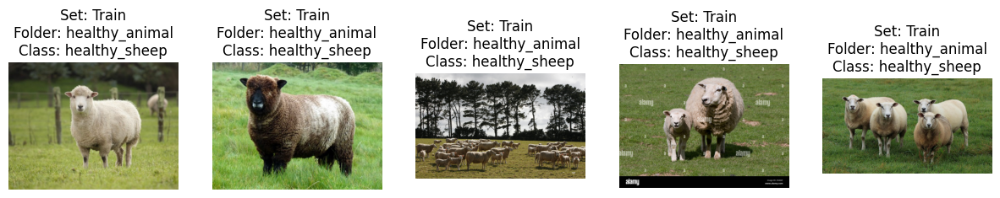

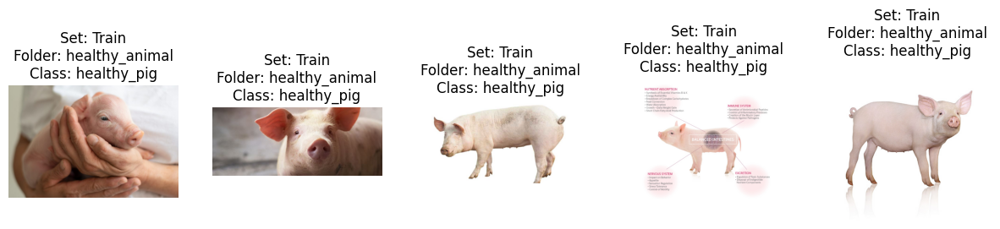

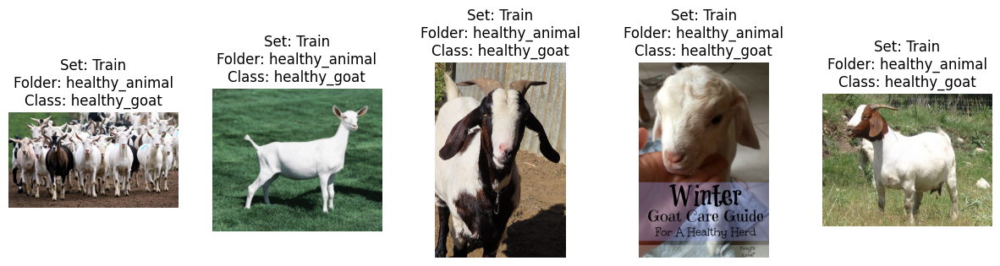

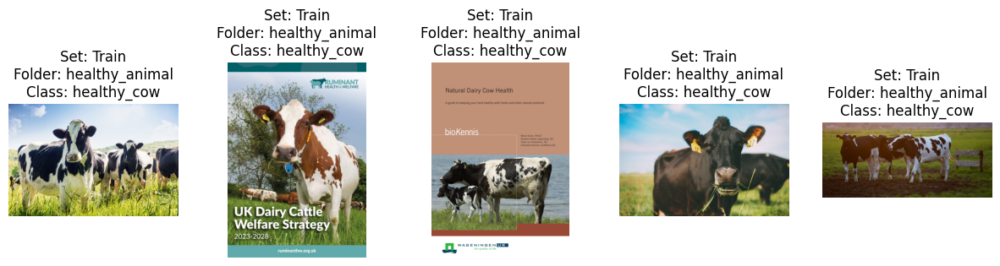

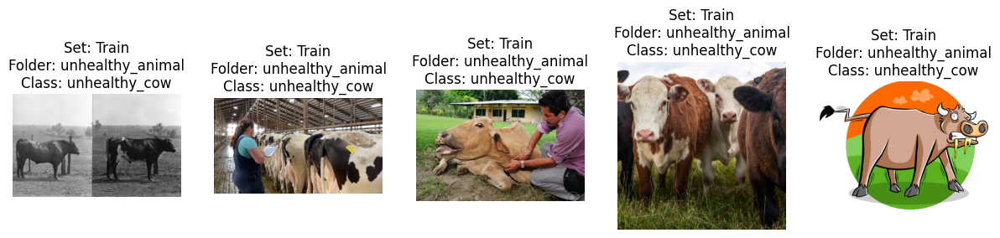

...

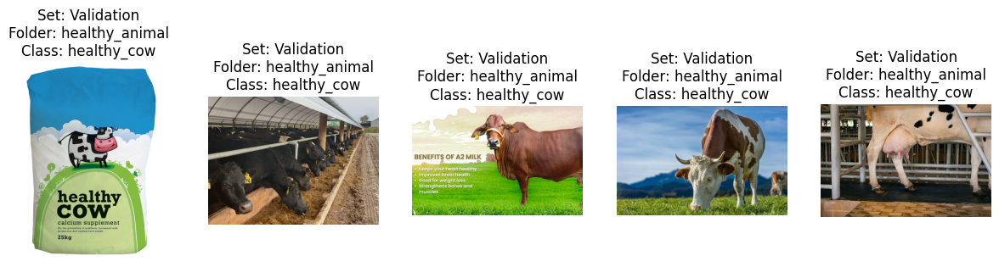

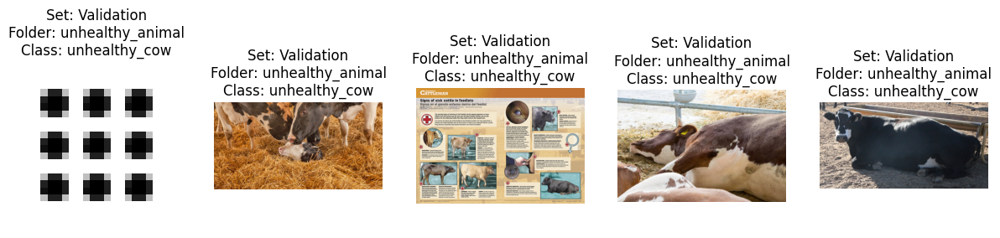

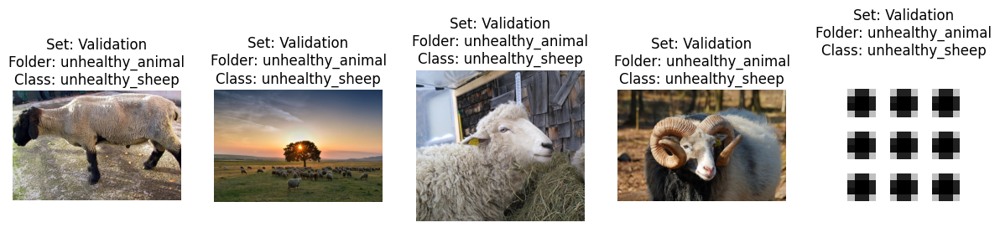

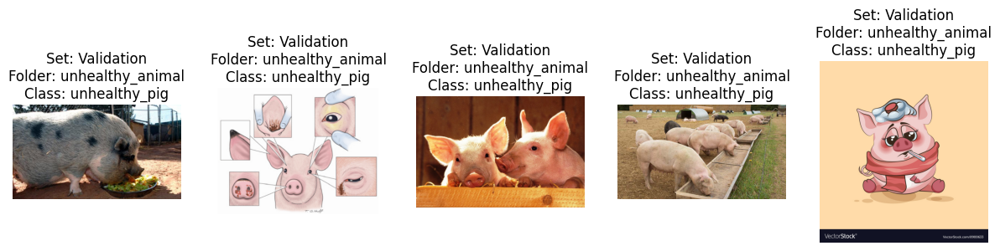

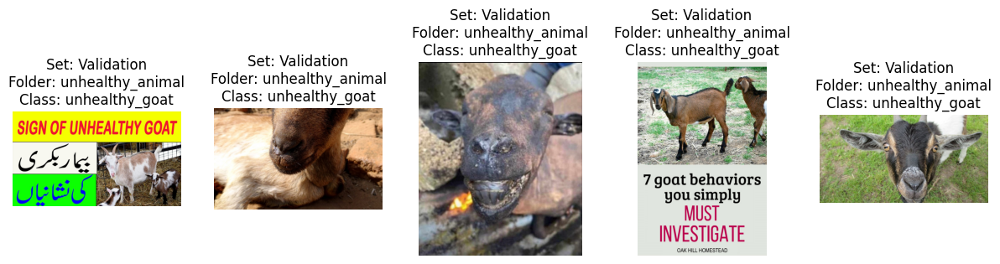

In [22]:


# Set the path to your dataset
dataset_path = "/content/drive/MyDrive/animals dataset"

# Function to display random images from a directory with set information
def display_random_images_with_info(directory, set_info, category, animal_type, num_images=5):
    image_files = random.sample(os.listdir(directory), num_images)

    fig, axes = plt.subplots(1, num_images, figsize=(15, 3))  # Adjust figsize as needed

    for i, image_file in enumerate(image_files):
        image_path = os.path.join(directory, image_file)
        img = mpimg.imread(image_path)

        # Display image with set information, folder, and class name
        axes[i].imshow(img)
        axes[i].set_title(f"Set: {set_info}\nFolder: {category}\nClass: {animal_type}")
        axes[i].axis('off')

    plt.show()

# Display random images from the train set
train_path = os.path.join(dataset_path, 'train')
categories = os.listdir(train_path)

for category in categories:
    category_path = os.path.join(train_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Train", category, animal_type)

# Display random images from the test set
test_path = os.path.join(dataset_path, 'test')

for category in categories:
    category_path = os.path.join(test_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Test", category, animal_type)

# Display random images from the validation set
validation_path = os.path.join(dataset_path, 'validation')

for category in categories:
    category_path = os.path.join(validation_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_with_info(animal_type_path, "Validation", category, animal_type)


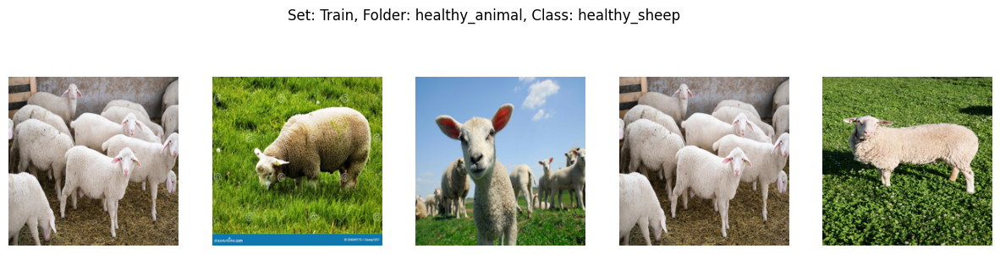

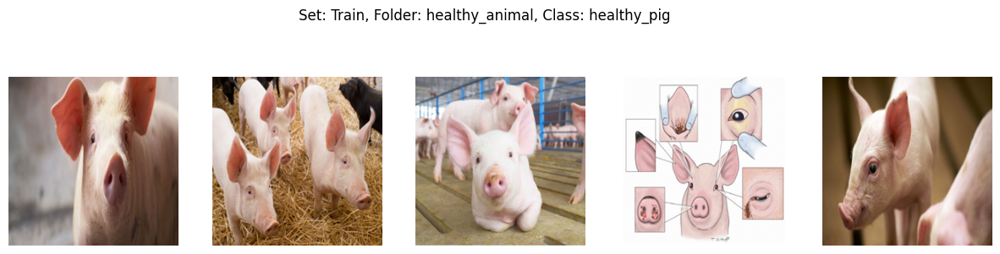

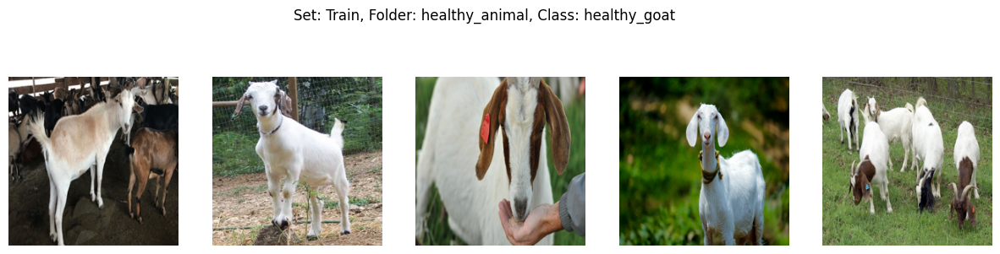

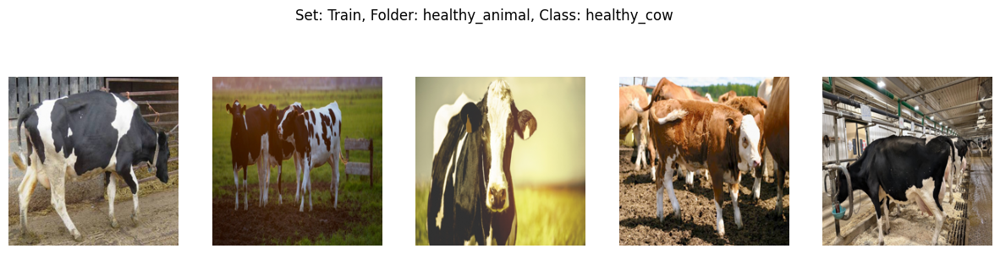

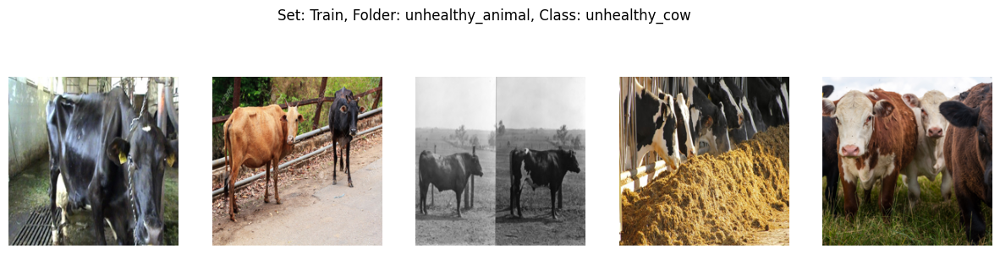

...

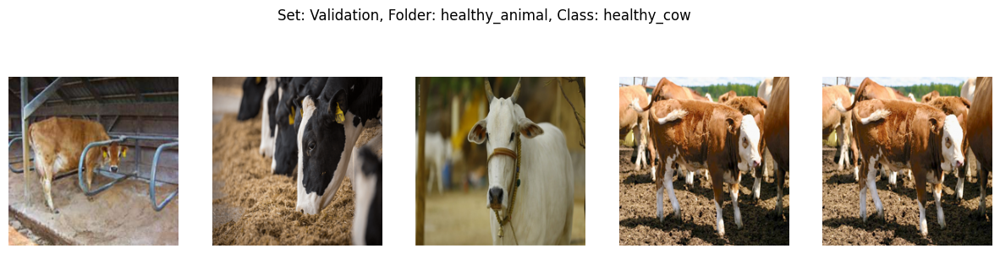

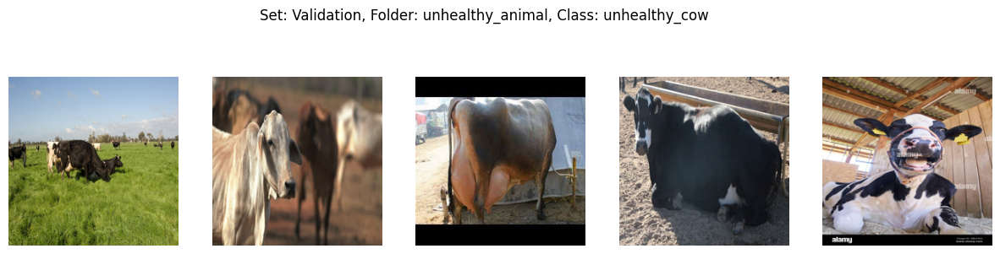

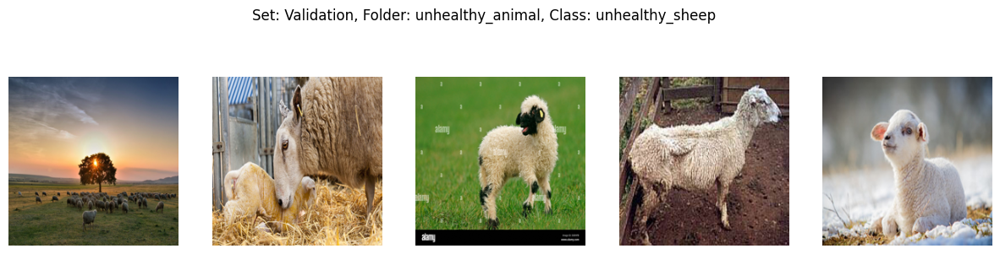

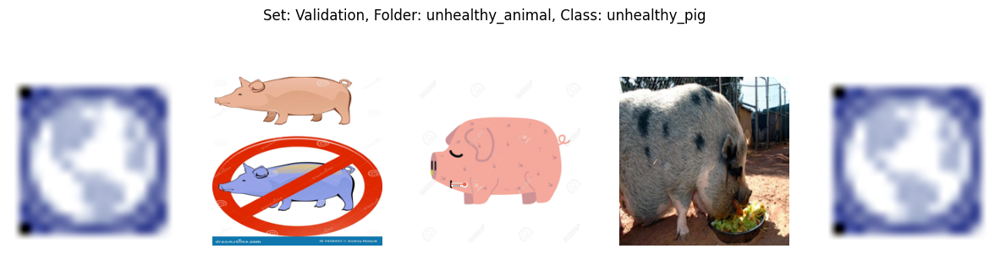

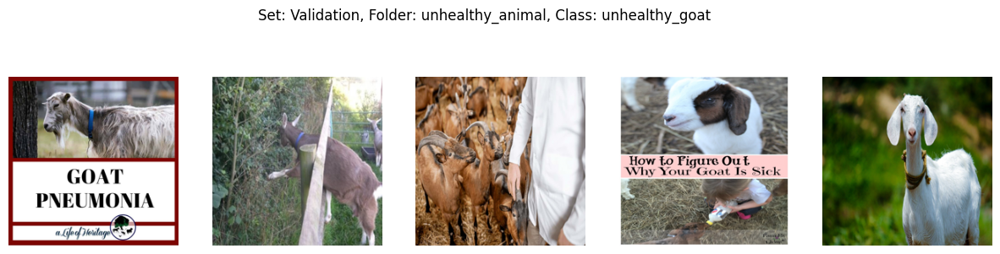

In [24]:

from PIL import Image


# Function to preprocess an image
def preprocess_image(image_path, target_size=(224, 224)):
    img = Image.open(image_path)

    # Convert to RGB mode if the image is not already in that mode
    if img.mode != 'RGB':
        img = img.convert('RGB')

    img = img.resize(target_size)
    img_array = np.array(img) / 255.0  # Normalize pixel values to [0, 1]
    return img_array

# Function to display all 5 random images in one row for each set with labels
def display_random_images_row(directory, set_info, category, animal_type, num_images=5):
    plt.figure(figsize=(15, 3))
    plt.suptitle(f"Set: {set_info}, Folder: {category}, Class: {animal_type}", y=1.1)

    image_files = random.sample(os.listdir(directory), num_images)

    for i, image_file in enumerate(image_files, 1):
        image_path = os.path.join(directory, image_file)
        img_array = preprocess_image(image_path)

        plt.subplot(1, num_images, i)
        plt.imshow(img_array)
        plt.axis('off')

    plt.show()

# Display all 5 random images in one row for the train set
train_path = os.path.join(dataset_path, 'train')
categories = os.listdir(train_path)

for category in categories:
    category_path = os.path.join(train_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_row(animal_type_path, "Train", category, animal_type)

# Display all 5 random images in one row for the test set
test_path = os.path.join(dataset_path, 'test')

for category in categories:
    category_path = os.path.join(test_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_row(animal_type_path, "Test", category, animal_type)

# Display all 5 random images in one row for the validation set
validation_path = os.path.join(dataset_path, 'validation')

for category in categories:
    category_path = os.path.join(validation_path, category)
    animal_types = os.listdir(category_path)

    for animal_type in animal_types:
        animal_type_path = os.path.join(category_path, animal_type)
        display_random_images_row(animal_type_path, "Validation", category, animal_type)


#summary of the model

In [25]:
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions

# Load the InceptionV3 model without trainable parameters
base_model = InceptionV3(weights='imagenet', include_top=True)
base_model.trainable = False

# Create your model by adding your custom layers on top of InceptionV3
model = tf.keras.Sequential([
    base_model,
    # Add your custom layers here (e.g., Flatten, Dense, etc.)
])

# Compile the model (you can customize the optimizer, loss, and metrics)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model summary
model.summary()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 1000)              23851784  
                                                                 
Total params: 23,851,784
Trainable params: 0
Non-trainable params: 23,851,784
_________________________________________________________________


#train the model

Found 4589 images belonging to 2 classes.
Found 986 images belonging to 2 classes.
Epoch 1/10
144/144 [==============================] - 963s 7s/step - loss: 0.4727 - accuracy: 0.7849 - val_loss: 0.2879 - val_accuracy: 0.8976
Epoch 2/10
144/144 [==============================] - 908s 6s/step - loss: 0.2100 - accuracy: 0.9209 - val_loss: 0.1494 - val_accuracy: 0.9442
Epoch 3/10
144/144 [==============================] - 936s 7s/step - loss: 0.1604 - accuracy: 0.9348 - val_loss: 0.2130 - val_accuracy: 0.9310
Epoch 4/10
144/144 [==============================] - 900s 6s/step - loss: 0.1418 - accuracy: 0.9425 - val_loss: 0.1200 - val_accuracy: 0.9564
Epoch 5/10
144/144 [==============================] - 889s 6s/step - loss: 0.1299 - accuracy: 0.9455 - val_loss: 0.1548 - val_accuracy: 0.9320
Epoch 6/10
144/144 [==============================] - 877s 6s/step - loss: 0.1289 - accuracy: 0.9429 - val_loss: 0.1455 - val_accuracy: 0.9412
Epoch 7/10
144/144 [==============================] - 920s 

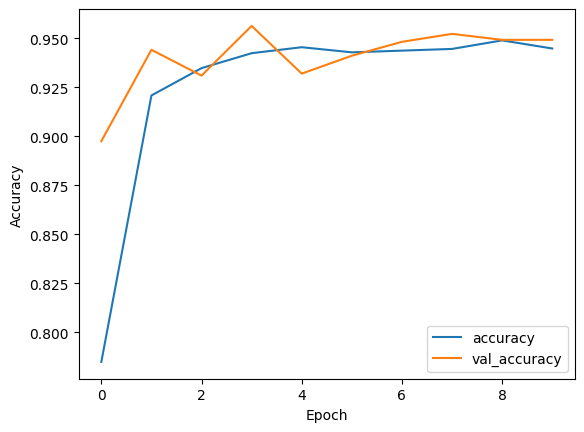

In [26]:

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import layers, models
from tensorflow.keras import layers, models, callbacks


# Define constants
input_shape = (224, 224, 3)
num_classes = len(os.listdir(os.path.join(dataset_path, 'train')))



# Data preprocessing without augmentation
datagen = ImageDataGenerator(rescale=1./255)

train_generator = datagen.flow_from_directory(
    os.path.join(dataset_path, 'train'),
    target_size=input_shape[:2],
    batch_size=32,
    class_mode='categorical'
)

validation_generator = datagen.flow_from_directory(
    os.path.join(dataset_path, 'validation'),
    target_size=input_shape[:2],
    batch_size=32,
    class_mode='categorical'
)




# Create an InceptionV3 model without trainable parameters
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)
base_model.trainable = False




# ... (your previous code)

# Define a ModelCheckpoint callback to save the best model during training
checkpoint_filepath = '/content/drive/MyDrive/animals dataset/best_model.h5'

model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=False,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)


# Build a model on top of the pre-trained base model
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
# Fit the model to the data with ModelCheckpoint callback
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[model_checkpoint_callback]
)

# Plot training history
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()




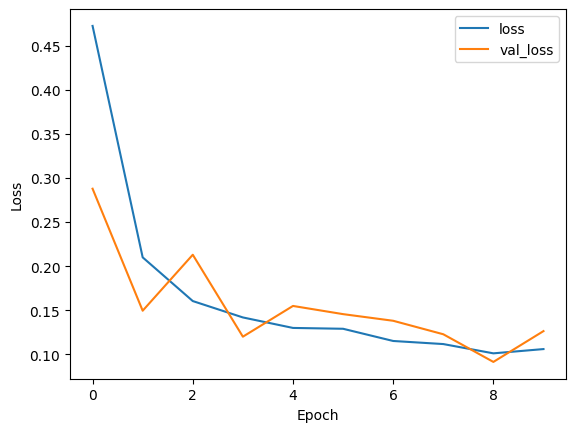

In [27]:
# Plot loss history
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

#testing and valdiation

In [29]:


# Assuming the path to the saved model is correct
saved_model_path = '/content/drive/MyDrive/animals dataset/best_model.h5'

# Load the saved model
loaded_model = tf.keras.models.load_model(saved_model_path)

# Assuming you have a test data generator
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    os.path.join(dataset_path, 'test'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

# Evaluate the model on the test data
test_loss, test_accuracy = loaded_model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy * 100:.2f}%')
print(f'Test Loss: {test_loss:.4f}')


Found 982 images belonging to 2 classes.
31/31 [==============================] - 170s 5s/step - loss: 0.1381 - accuracy: 0.9348
Test Accuracy: 93.48%
Test Loss: 0.1381


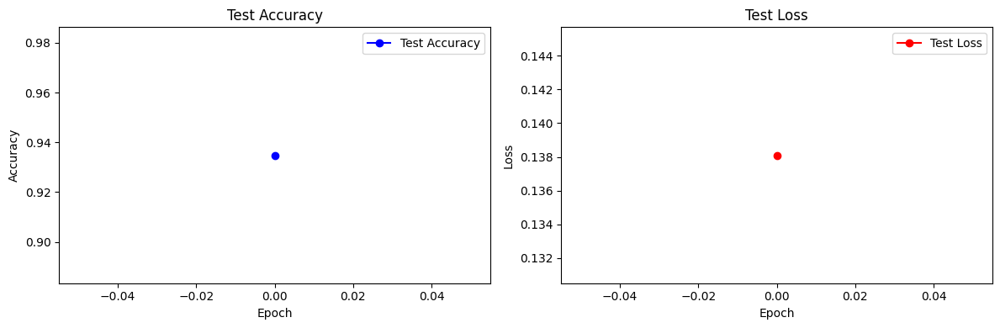

In [30]:
# Plot test history
plt.figure(figsize=(12, 4))

# Plot Test Accuracy
plt.subplot(1, 2, 1)
plt.plot(test_accuracy, label='Test Accuracy', marker='o', linestyle='-', color='b')
plt.title('Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Test Loss
plt.subplot(1, 2, 2)
plt.plot(test_loss, label='Test Loss', marker='o', linestyle='-', color='r')
plt.title('Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

31/31 [==============================] - 155s 5s/step - loss: 0.1200 - accuracy: 0.9564
Validation Accuracy: 95.64%
Validation Loss: 0.1200


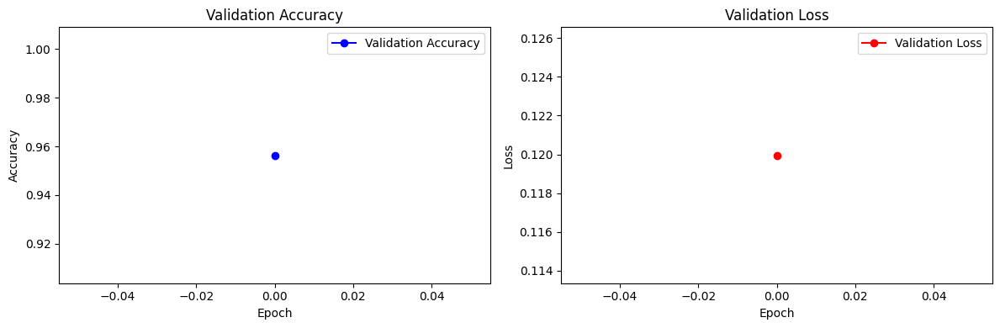

In [31]:
# Evaluate the model on the validation data
validation_loss, validation_accuracy = loaded_model.evaluate(validation_generator)
print(f'Validation Accuracy: {validation_accuracy * 100:.2f}%')
print(f'Validation Loss: {validation_loss:.4f}')

# Plot validation history
plt.figure(figsize=(12, 4))

# Plot Validation Accuracy
plt.subplot(1, 2, 1)
plt.plot(validation_accuracy, label='Validation Accuracy', marker='o', linestyle='-', color='b')
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Validation Loss
plt.subplot(1, 2, 2)
plt.plot(validation_loss, label='Validation Loss', marker='o', linestyle='-', color='r')
plt.title('Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#rondam prediction

1/1 [==============================] - 0s 454ms/step


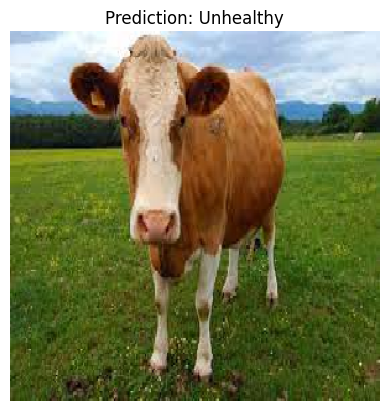

In [40]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input

# Load and resize the image to match the InceptionV3 input shape
image_path = '/content/cow.jpg'
img = image.load_img(image_path, target_size=(299, 299))  # Resize to match the InceptionV3 input shape
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Assuming a binary classification task
class_names = ["Healthy", "Unhealthy"]
predicted_class = class_names[np.argmax(predictions)]

# Display the image with predicted class
plt.imshow(img)
plt.title(f'Prediction: {predicted_class}')
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 260ms/step


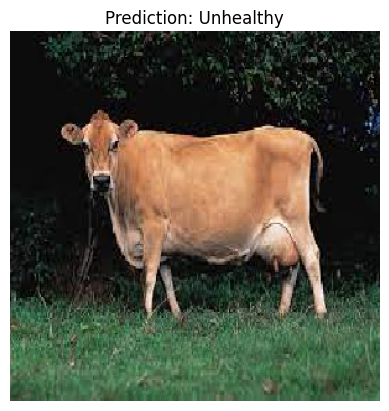

In [41]:


# Load and resize the image to match the InceptionV3 input shape
image_path = '/content/download.jpg'
img = image.load_img(image_path, target_size=(299, 299))  # Resize to match the InceptionV3 input shape
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Assuming a binary classification task
class_names = ["Healthy", "Unhealthy"]
predicted_class = class_names[np.argmax(predictions)]

# Display the image with predicted class
plt.imshow(img)
plt.title(f'Prediction: {predicted_class}')
plt.axis('off')
plt.show()


1/1 [==============================] - 1s 636ms/step


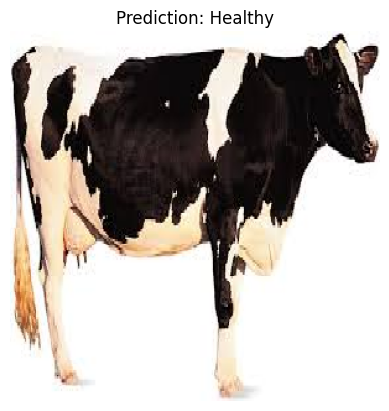

In [43]:


# Load and resize the image to match the InceptionV3 input shape
image_path = '/content/images (1).jpg'
img = image.load_img(image_path, target_size=(299, 299))  # Resize to match the InceptionV3 input shape
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Assuming a binary classification task
class_names = ["Healthy", "Unhealthy"]
predicted_class = class_names[np.argmax(predictions)]

# Display the image with predicted class
plt.imshow(img)
plt.title(f'Prediction: {predicted_class}')
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 440ms/step


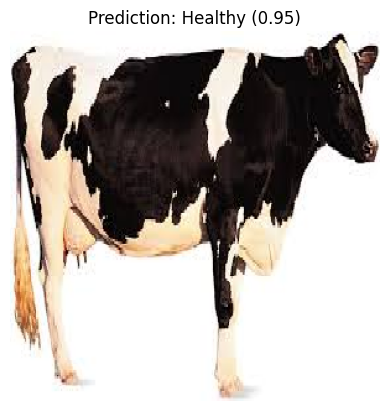

In [45]:


# Load and resize the image to match the InceptionV3 input shape
image_path = '/content/images (1).jpg'
img = image.load_img(image_path, target_size=(299, 299))  # Resize to match the InceptionV3 input shape
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Assuming a binary classification task
class_names = ["Healthy", "Unhealthy"]
predicted_class_index = np.argmax(predictions)
predicted_class = class_names[predicted_class_index]
confidence = predictions[0][predicted_class_index]

# Display the image with predicted class and probability
plt.imshow(img)
plt.title(f'Prediction: {predicted_class} ({confidence:.2f})')
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 406ms/step


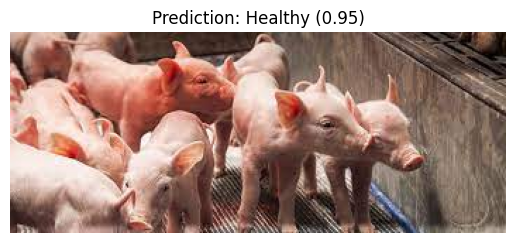

In [51]:

# Load and preprocess the new image
new_image_path = '/content/download (2).jpg'  # Replace with the path to your new image
img = image.load_img(new_image_path, target_size=(224, 224))  # Assumes the same target size used during training
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Assuming a binary classification task
class_names = ["Healthy", "Unhealthy"]
predicted_class_index = np.argmax(predictions)
predicted_class = class_names[predicted_class_index]
confidence = predictions[0][predicted_class_index]

# Display the new image with predicted class and probability
img = image.load_img(new_image_path)
plt.imshow(img)
plt.title(f'Prediction: {predicted_class} ({confidence:.2f})')
plt.axis('off')
plt.show()


#this code assuming heirarcal trained model but we didnot trained

In [54]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions
# Load and preprocess the new image
new_image_path = '/content/cow.jpg'
img = image.load_img(new_image_path, target_size=(224, 224))
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# Make predictions
predictions = loaded_model.predict(img_array)

# Check if predictions array is not empty and has the expected shape
if predictions.size == 0 or predictions.shape[1] < 6:  # Adjust the expected shape based on your model output
    print("Invalid predictions array. Ensure your model output has the expected shape.")
else:
    # Assuming a binary classification task
    class_names = ["Healthy", "Unhealthy"]

    # Extract predicted class indices
    predicted_class_index = np.argmax(predictions[:, :2])  # Assuming the first two elements correspond to binary classification
    confidence_class = predictions[0, predicted_class_index]

    # Check if the predictions array has the expected shape for category classification
    if predictions.shape[1] >= 6:  # Adjust the condition based on your model output
        # Assuming the next four elements correspond to category classification
        category_names = ["Cow", "Goat", "Pig", "Sheep"]
        predicted_category_index = np.argmax(predictions[:, 2:]) + 2
        predicted_category = category_names[predicted_category_index]
        confidence_category = predictions[0, predicted_category_index]
    else:
        print("Category predictions not available.")

    # Display the new image with predicted class and category
    img = image.load_img(new_image_path)
    plt.imshow(img)
    plt.title(f'Prediction: {class_names[predicted_class_index]} ({confidence_class:.2f})\nCategory: {predicted_category} ({confidence_category:.2f})')
    plt.axis('off')
    plt.show()


1/1 [==============================] - 0s 377ms/step
Invalid predictions array. Ensure your model output has the expected shape.


#this code is for paralel runing and monitering thhe model performance

In [ ]:
"""import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt
import concurrent.futures

# Set the path to your dataset
dataset_path = "/content/drive/MyDrive/animals dataset"

# Define constants
input_shape = (224, 224, 3)
num_classes = len(os.listdir(os.path.join(dataset_path, 'train')))

# Create an InceptionV3 model without trainable parameters
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)
base_model.trainable = False

# Build a model on top of the pre-trained base model
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Data preprocessing without augmentation
datagen = ImageDataGenerator(rescale=1./255)

train_generator = datagen.flow_from_directory(
    os.path.join(dataset_path, 'train'),
    target_size=input_shape[:2],
    batch_size=32,
    class_mode='categorical'
)

validation_generator = datagen.flow_from_directory(
    os.path.join(dataset_path, 'validation'),
    target_size=input_shape[:2],
    batch_size=32,
    class_mode='categorical'
)

# Function to train the model
def train_model(epochs):
    history = model.fit(
        train_generator,
        epochs=epochs,
        validation_data=validation_generator,
        verbose=0  # Set verbose to 0 to suppress output during training
    )
    return history

# Function to plot the training history
def plot_history(history):
    plt.plot(history.history['accuracy'], label='accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

# Run training and plotting in parallel
with concurrent.futures.ThreadPoolExecutor() as executor:
    # Submit the training task
    training_task = executor.submit(train_model, epochs=10)

    # Submit the plotting task
    plotting_task = executor.submit(plot_history, training_task.result())

# Wait for both tasks to complete
training_task.result()
"""